# Разведочный анализ датасета изображений овощей и фруктов

**Цели ноутбука:**   
* Провести анализ характеристик изображений
* Провести анализ метаданных изображений
* Провести визуальный анализ изображений
* Визуализировать данные
* Провести первичную предобработку
* Сделать выводы по структуре данных

Для разведочного анализа используется подготовленный датасет, состоящий из изображений овощей и фруктов

In [1]:
# Для работы с EXIF-данными картинок
!pip install exif

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.0/70.0 kB 3.3 MB/s eta 0:00:00


In [30]:
import zipfile
import os
import shutil

import matplotlib.pyplot as plt
from PIL import Image, ExifTags, ImageOps
import random
from tqdm.auto import tqdm
import seaborn as sns
import numpy as np
import cv2
import pandas as pd

# Для работы с EXIF-данными картинок
import exif

In [3]:
try:
    from google.colab import drive
    drive.mount('/content/drive')
    DRIVE_DIR = os.path.join('/content/drive', 'MyDrive')
except ImportError:
    DRIVE_DIR = os.getcwd()

DATASET_DIR = os.path.join(os.getcwd(), 'dataset')
os.makedirs(DATASET_DIR, exist_ok=True)

Mounted at /content/drive


In [4]:
# Распаковка архива
with zipfile.ZipFile(os.path.join(DRIVE_DIR,'final_dataset.zip'), 'r') as zip_ref:
    zip_ref.extractall('./dataset')

# Проверим структуру папок
print(f' В папке {os.listdir(DATASET_DIR)} файлов')

 В папке ['Plum', 'Pinenapple', 'Strawberry', 'Apple', 'Kiwi', 'Pear', 'Avocado', 'Bottle_Gourd', 'Peach', 'Watermelon', 'Papaya', 'Stawberries', 'Radish', 'Cauliflower', 'Mango', 'Bitter_Gourd', 'Carrot', 'Pumpkin', 'Cabbage', 'Brinjal', 'Pepper', 'Orange', 'Onion', 'Capsicum', 'Grape', 'Tomato', 'Banana', 'Cucumber', 'Potato', 'Broccoli', 'Bean', 'Nut', 'Cherry'] файлов


In [5]:
# Список категорий
categories = os.listdir(DATASET_DIR)
category_counts = {category: len(os.listdir(os.path.join(DATASET_DIR, category))) for category in categories}

print(f"Категории: {', '.join(categories)}")

Категории: Plum, Pinenapple, Strawberry, Apple, Kiwi, Pear, Avocado, Bottle_Gourd, Peach, Watermelon, Papaya, Stawberries, Radish, Cauliflower, Mango, Bitter_Gourd, Carrot, Pumpkin, Cabbage, Brinjal, Pepper, Orange, Onion, Capsicum, Grape, Tomato, Banana, Cucumber, Potato, Broccoli, Bean, Nut, Cherry


## 1. Анализ характеристик изображений

### Средние, минимальные и максимальные размеры изображений

Нахождение среднего, минимального и максимального размера изображений поможет определить оптимальный размер для последующей обработки. Получим размеры изображений и рассчитаем средние, минимальные и максимальные размеры.

In [6]:
# Функция для возврата списка строк вида [категория, имя файла, ширина, высота]
def check_image_sizes(folder_path, category):
    sizes = []
    for img in os.listdir(folder_path):
        image = Image.open(os.path.join(folder_path, img))
        sizes.append([category, img, *image.size])
    return sizes

In [7]:
# Соберу строки с инофрмацией о размерах, пройдясь по папкам категорий
row_list = []
for category in tqdm(categories):
    folder_path = os.path.join(DATASET_DIR, category)
    row_list.extend(check_image_sizes(folder_path, category))

print('Строки имеют вид:')
print(row_list[0])

  0%|          | 0/33 [00:00<?, ?it/s]

Строки имеют вид:
['Plum', '32_r_78_100.jpg', 100, 100]


In [8]:
df = pd.DataFrame(row_list, columns=['category', 'name', 'width', 'height'])
df.describe()

,width,height
count,46200.000000,46200.000000
mean,180.577446,170.208745
std,69.201081,59.957772
min,100.000000,100.000000
25%,100.000000,100.000000
50%,224.000000,192.000000
75%,224.000000,224.000000
max,453.000000,363.000000


**Среднее значение ширины - 180px, высоты - 170px**  
**Минимальные размеры для ширины и высоты - 100px**. Значительная часть (около 25% датасета) представлена в таком размере.  
**Максимальное значение для ширины - 453px, высоты - 336px**.

Половина изображений имеют ширину до 224px и высоту до 192px, а три четверти изображений имеют размер по ширине и высоте до 224px.

Большая часть изображений из представленных имеют размеры *100x100px* и *224x224px*.
При изменении размера изображений к 224x224px большинство изображений не потеряет деталей, также **данный размер используется в нейронных сетях ResNet, VGG**.  
При приведении датасета к данному размеру многие изображения не придется изменять. Крупных изображений немного, их можно уменьшить без сильной потери информациии.

**Решено использовать размер для изображений 224*224px**

### Средние значения и отклонения по каналам (R, G, B)

Средние значения по каналам могут быть использованы для нормализации изображений, что улучшает обучение моделей.  
Вычислим среднее и стандартное отклонение по каждому из трех каналов (красный, зеленый, синий) для всех изображений.

In [9]:
# Функция для возврата списка строк вида [категория, имя файла, среднее отклонение rgb, стандартное отклонение rgb]
def check_image_color(folder_path, category):
    colors = []
    for img in os.listdir(folder_path):
        image = Image.open(os.path.join(folder_path, img))
        img_rgb = image.convert("RGB")
        np_img = np.array(img_rgb)
        np_img = np.array(img_rgb)

        r = np_img[:, :, 0].flatten()
        g = np_img[:, :, 1].flatten()
        b = np_img[:, :, 2].flatten()
        r_mean, g_mean, b_mean = np.mean(r), np.mean(g), np.mean(b)
        r_std, g_std, b_std = np.std(r), np.std(g), np.std(b)
        colors.append([category, img, r_mean, g_mean, b_mean, r_std, g_std, b_std])
    return colors

In [10]:
# Соберу строки с инофрмацией о RGB, пройдясь по папкам категорий
row_list = []
for category in tqdm(categories):
    folder_path = os.path.join(DATASET_DIR, category)
    row_list.extend(check_image_color(folder_path, category))

print('Строки имеют вид:')
print(row_list[0])

  0%|          | 0/33 [00:00<?, ?it/s]

Строки имеют вид:
['Plum', '32_r_78_100.jpg', 112.1882, 92.8101, 106.9234, 91.83774921436174, 107.08865036963535, 100.4593217797134]


In [11]:
rgb_df = pd.DataFrame(row_list, columns=['category', 'name', 'mean_R', 'mean_G', 'mean_B', 'std_R', 'std_G', 'std_B'])
rgb_df.describe()

,mean_R,mean_G,mean_B,std_R,std_G,std_B
count,46200.000000,46200.000000,46200.000000,46200.000000,46200.000000,46200.000000
mean,147.470545,133.555412,108.320379,60.546454,67.447260,72.103187
std,42.012212,37.391561,42.382131,18.047997,21.103450,25.483715
min,33.152932,17.883299,3.892797,1.499134,2.812498,5.992393
25%,112.220379,108.930824,76.032863,48.776095,51.930454,48.259238
50%,145.163390,128.137868,104.018600,58.542463,63.277277,74.872475
75%,178.964840,157.553527,138.189007,72.227877,84.246682,93.926047
max,254.650194,254.573413,250.725858,117.175420,120.794774,124.139301


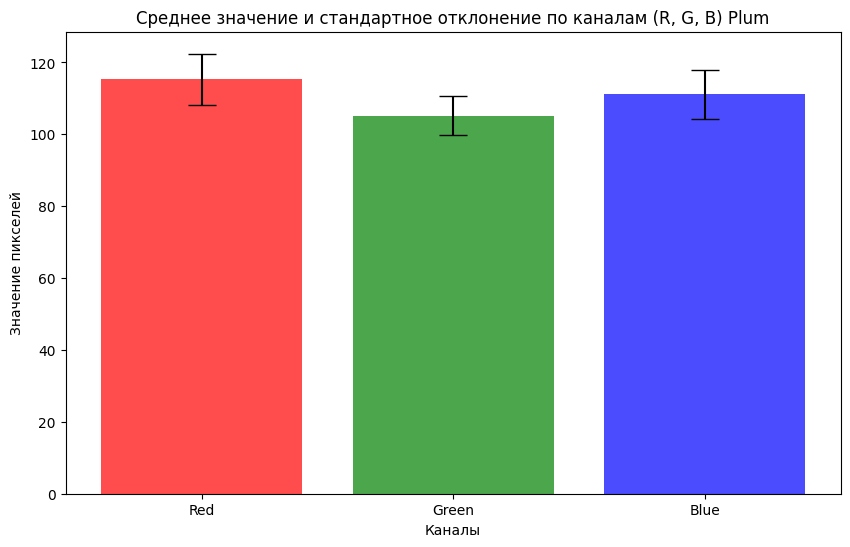

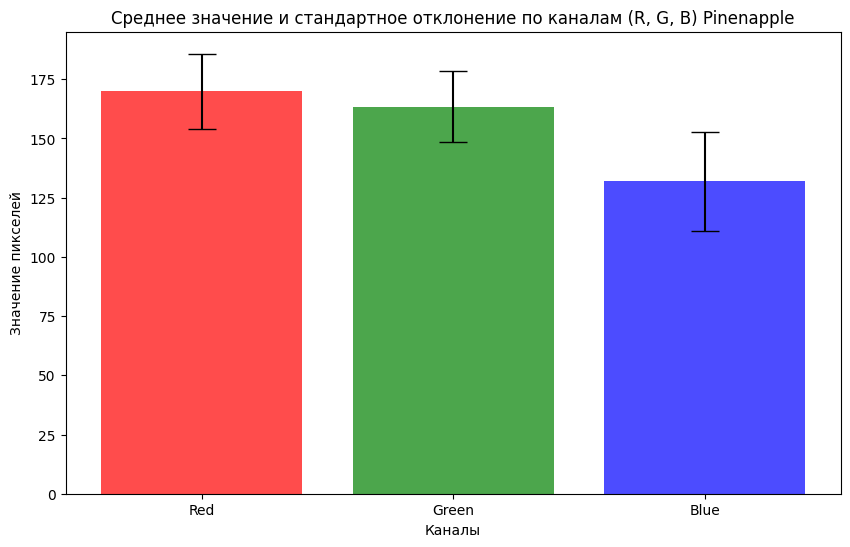

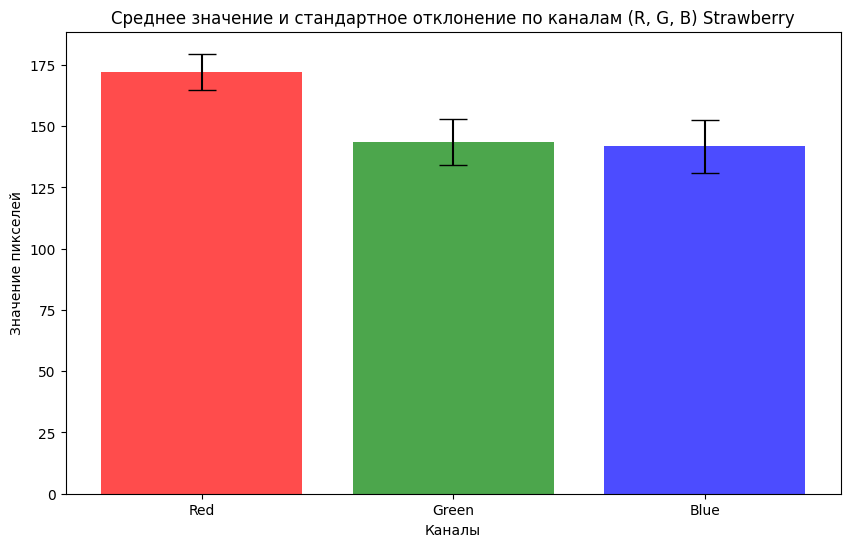

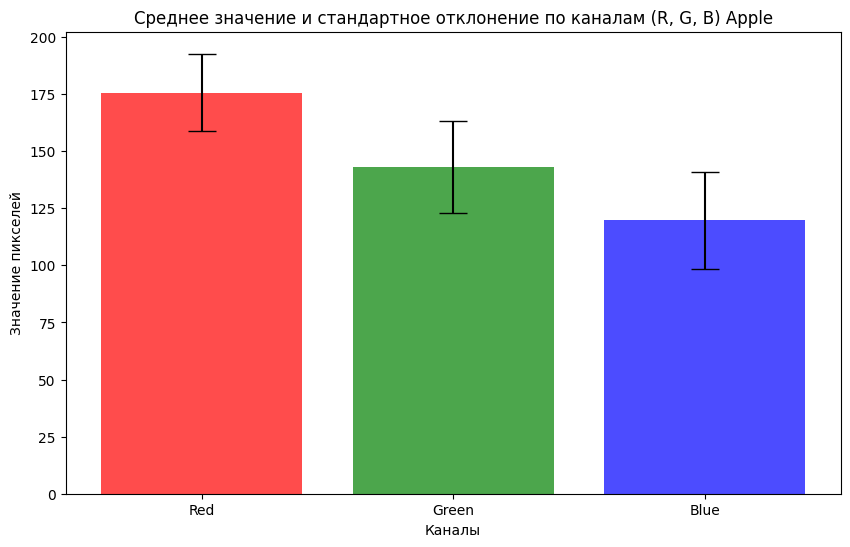

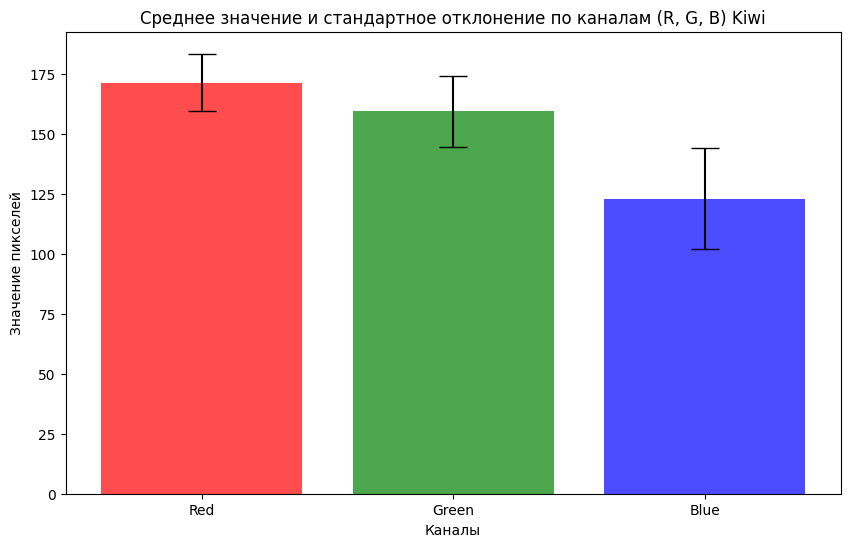

...

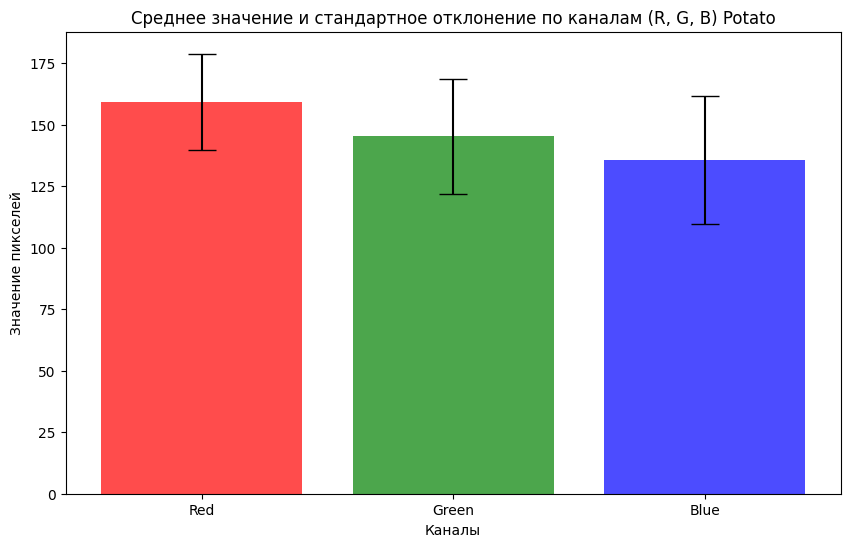

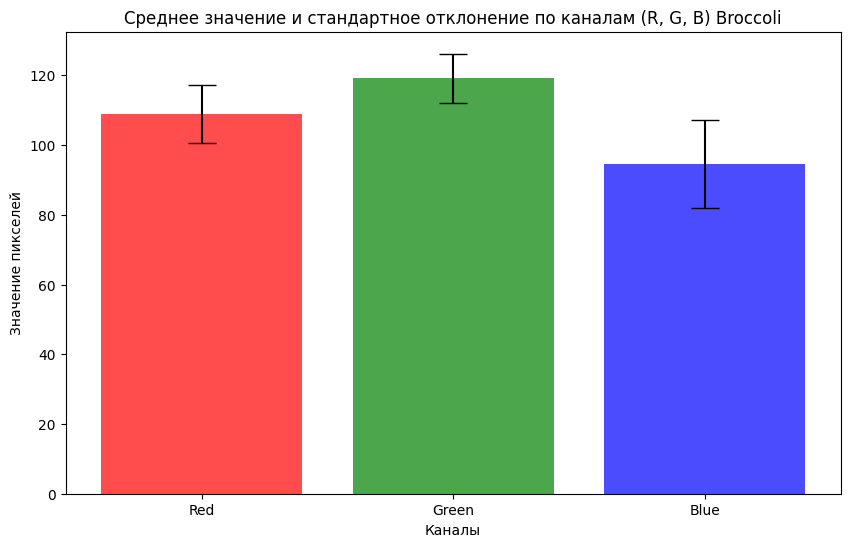

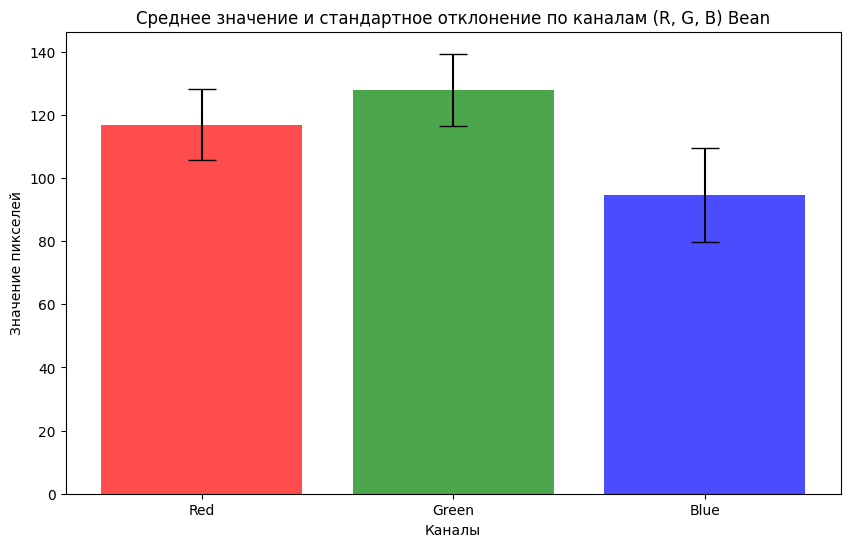

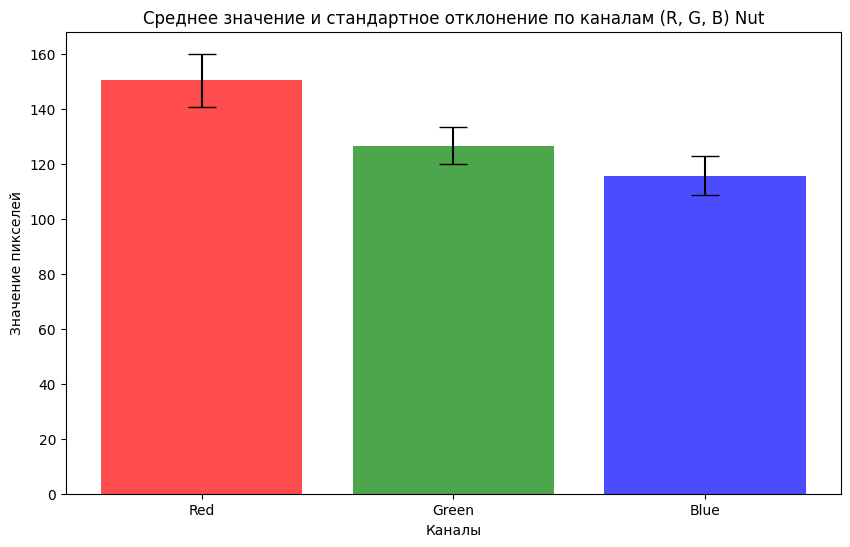

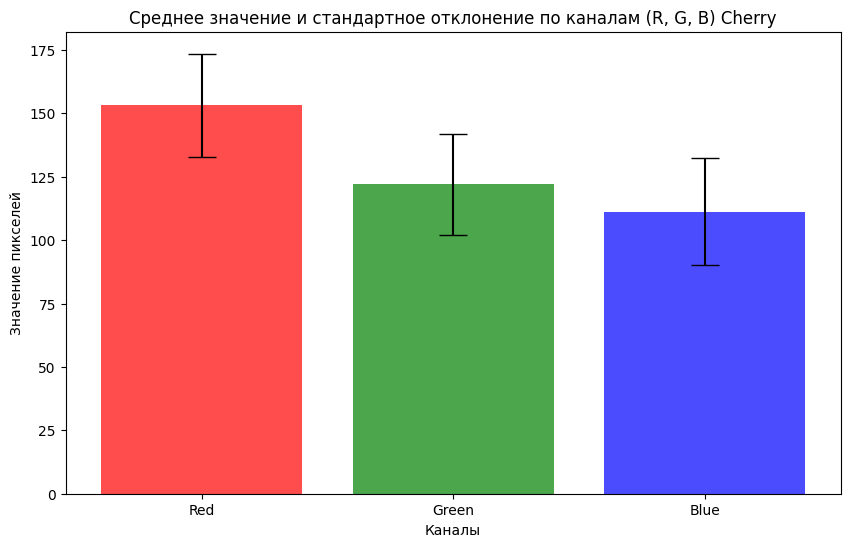

In [12]:
channels = ['Red', 'Green', 'Blue']
for category in rgb_df['category'].unique():
    rows = rgb_df[rgb_df['category'] == category].values
    mean_r = np.mean(rows[:, 2])
    mean_g = np.mean(rows[:, 3])
    mean_b = np.mean(rows[:, 4])
    std_r = np.std(rows[:, 5])
    std_g = np.std(rows[:, 6])
    std_b = np.std(rows[:, 7])
    means = [mean_r, mean_g, mean_b]
    stds = [std_r, std_g, std_b]

    plt.figure(figsize=(10, 6))

    # Построим бар-график для среднего значения и стандартного отклонения
    plt.bar(channels, means, yerr=stds, capsize=10, color=['r', 'g', 'b'], alpha=0.7)

    plt.title(f'Среднее значение и стандартное отклонение по каналам (R, G, B) {category}')
    plt.ylabel('Значение пикселей')
    plt.xlabel('Каналы')
    plt.show()

Заметно, что стандартное отклонение сильно варьируется от категории к категории. В некоторых категориях имеются похожие изображения (изображения одного и того же объекта под разными углами, к примеру), это сказывается на стандартном отклонении.

## 2. Анализ метаданных изображений

У изображений могут быть метаданные. Стоит проверить EXIF в файлах, если у файлов будут найдены метаданные их можно будет использовать как дополнительные признаки

In [13]:
# Вернет строки вида [категория, имя файла, модель фотоаппарата, значение диафрагмы, значение яркости, фокусное расстояние, коэф. цифрового масштабирования]
def check_exif_data(folder_path, category):
    exif_rows = []
    for img in os.listdir(folder_path):
        try:
            image = exif.Image(os.path.join(folder_path, img))
            if image.has_exif:
                # Добавляю модель фотоаппарата,
                exif_rows.append([category, img, image.get('model'), image.get('aperture_value'), image.get('brightness_value'), image.get('focal_length'), image.get('digital_zoom_ratio')])
            else:
                exif_rows.append([category, img, None, None, None, None, None])
        except:
            print('Не удалось прочитать EXIF')
            exif_rows.append([category, img, None, None, None, None, None])
    return exif_rows

In [14]:
# Соберу строки с инофрмацией о EXIF, пройдясь по папкам категорий
exif_rows = []
for category in tqdm(categories):
    folder_path = os.path.join(DATASET_DIR, category)
    exif_rows.extend(check_exif_data(folder_path, category))

  0%|          | 0/33 [00:00<?, ?it/s]

Не удалось прочитать EXIF


/usr/local/lib/python3.10/dist-packages/exif/_image.py:171: RuntimeWarning: ASCII tag contains 16 fewer bytes than specified
  retval = getattr(self, attribute)


Не удалось прочитать EXIF
Не удалось прочитать EXIF
Не удалось прочитать EXIF
Не удалось прочитать EXIF


In [15]:
exif_df = pd.DataFrame(exif_rows, columns=['category', 'name', 'model', 'aperture_value', 'brightness_value', 'focal_length', 'digital_zoom_ratio'])

exif_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46200 entries, 0 to 46199
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   category            46200 non-null  object 
 1   name                46200 non-null  object 
 2   model               4282 non-null   object 
 3   aperture_value      4268 non-null   float64
 4   brightness_value    2884 non-null   float64
 5   focal_length        4281 non-null   float64
 6   digital_zoom_ratio  3254 non-null   float64
dtypes: float64(4), object(3)
memory usage: 2.5+ MB


**У некоторых картинок встречаются EXIF**, в дальнейшем их можно будет использовать как дополнительные признаки

In [16]:
exif_df.describe(include='all')

,category,name,model,aperture_value,brightness_value,focal_length,digital_zoom_ratio
count,46200,46200,4282,4268.000000,2884.000000,4281.000000,3254.000000
unique,33,27353,36,NaN,NaN,NaN,NaN
top,Plum,0134.jpg,SM-A515F,NaN,NaN,NaN,NaN
freq,1400,15,2884,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,2.015685,3.657165,6.534618,0.940074
std,NaN,NaN,NaN,0.483090,4.544207,6.415187,0.237387
min,NaN,NaN,NaN,1.610000,-6.340000,3.610000,0.000000
25%,NaN,NaN,NaN,1.690000,0.157500,4.600000,1.000000
50%,NaN,NaN,NaN,2.000000,3.595000,4.600000,1.000000
75%,NaN,NaN,NaN,2.000000,6.700000,4.745000,1.000000


In [17]:
def show_min_max(df, columns):
    for col in columns:
        min_row = df[df[col] == df[col].min()].iloc[0]
        max_row = df[df[col] == df[col].max()].iloc[0]
        rows_to_display = [min_row, max_row]
        titles = [min_row[col], max_row[col]]
        plt.figure(figsize=(7, 3))
        for i, row in enumerate(rows_to_display):
            img_category_path = os.path.join(DATASET_DIR, row['category'])
            img_path = os.path.join(img_category_path, row['name'])
            img = Image.open(img_path)
            plt.subplot(1, 3, i + 1)
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"{row['name']} - {titles[i]}")
        plt.suptitle(f"Минимальное и максимальное значение изображений для {col}", fontsize=16)
        plt.show()

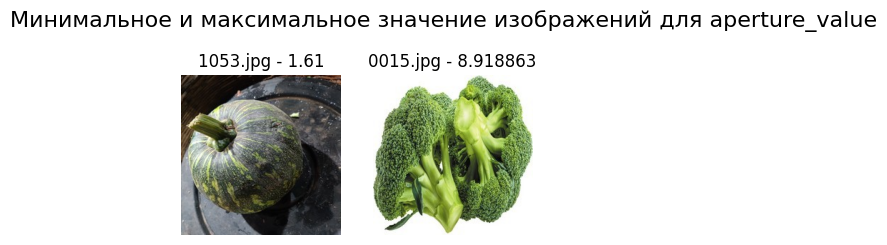

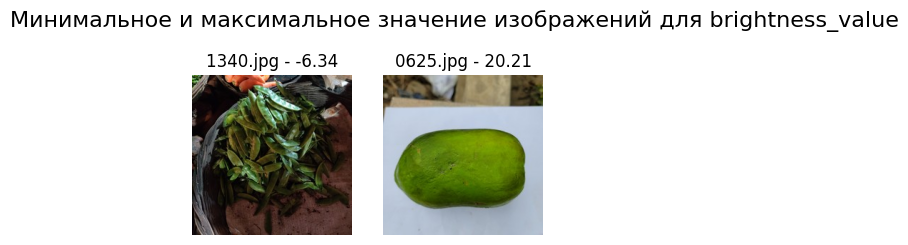

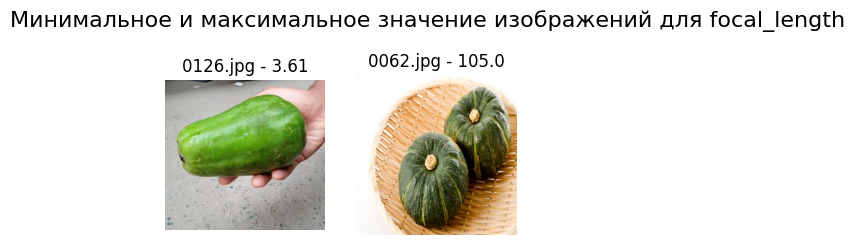

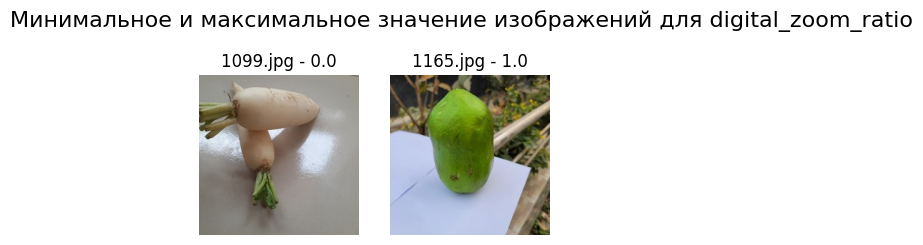

In [18]:
show_min_max(exif_df, ['aperture_value',	'brightness_value',	'focal_length',	'digital_zoom_ratio'])

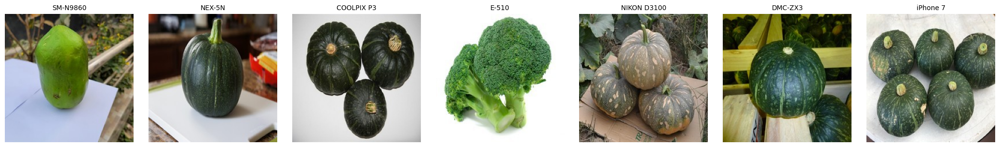

In [19]:
models = random.sample(list(exif_df['model'].dropna().unique()), 7)
fig, axes = plt.subplots(1, 7, figsize=(21, 3))

for i, model in enumerate(models):
    row = exif_df[exif_df['model'] == model].iloc[0]
    img_category_path = os.path.join(DATASET_DIR, row['category'])
    img_path = os.path.join(img_category_path, row['name'])
    img = Image.open(img_path)
    axes[i].imshow(img)
    axes[i].axis('off')
    axes[i].set_title(model, fontsize=10)
plt.tight_layout()
plt.show()

Визуально заметно, что изображения с различным фокусным расстоянием и яркостью отличаются друг от друга по этим признакам.  
Также качество изображений отличается в зависимости от модели камеры.

*Метаданные могут пригодиться в дальнейшей работе*

## 3. Изучение связи изображений с целевой переменной

Визуально проанализируем несколько примеров изображений из каждого класса, чтобы лучше понять взаимосвязь между изображением и целевой переменной

In [20]:
# Функция для отображения нескольких изображений из категории
def show_images(folder_path, category, num_images=5):
    image_files = random.sample(os.listdir(folder_path), num_images)

    plt.figure(figsize=(15, 5))
    for i, img_name in enumerate(image_files):
        img_path = os.path.join(folder_path, img_name)
        img = Image.open(img_path)

        plt.subplot(1, num_images, i+1)
        plt.imshow(img)
        plt.title(category)
        plt.axis('off')
    plt.show()

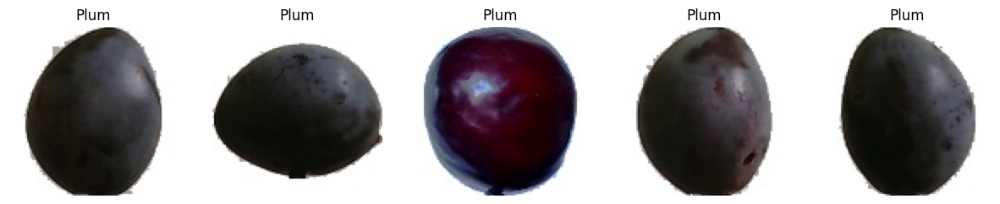

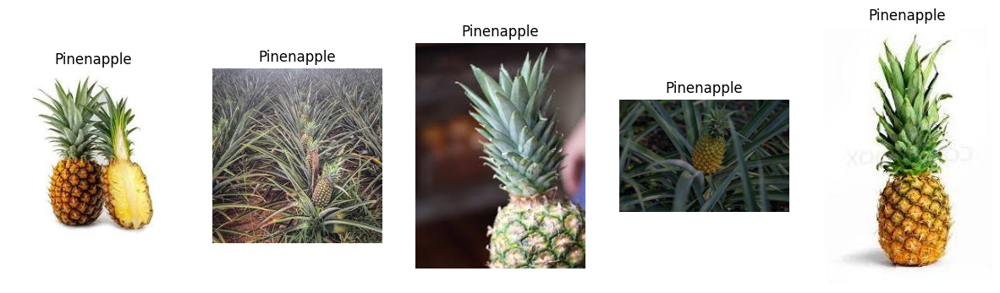

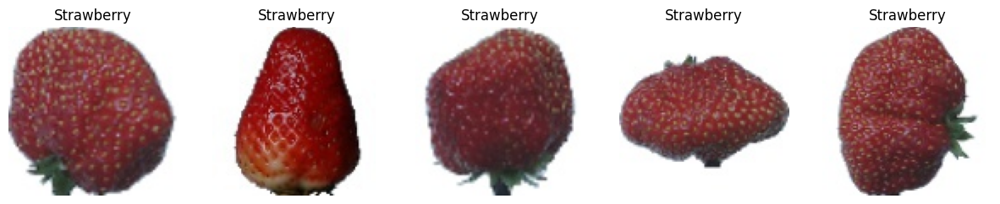

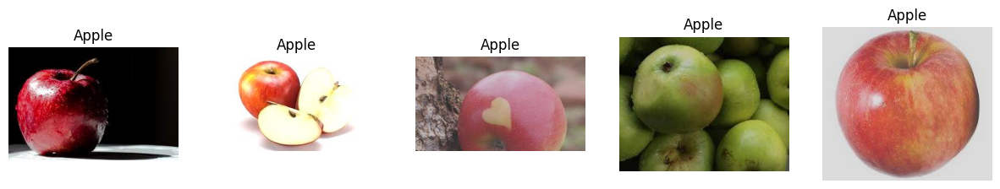

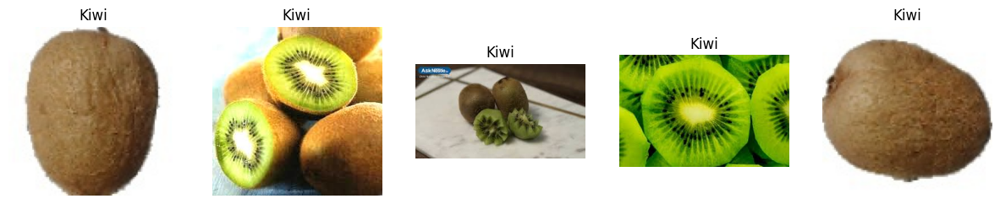

...

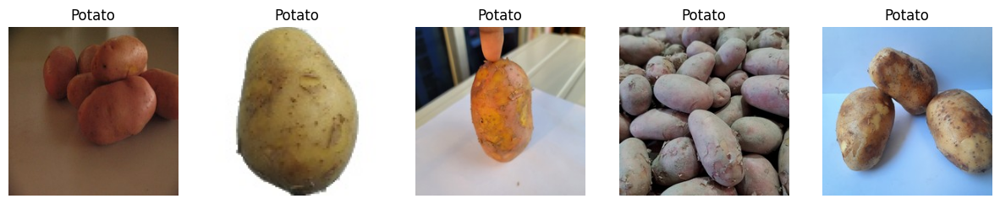

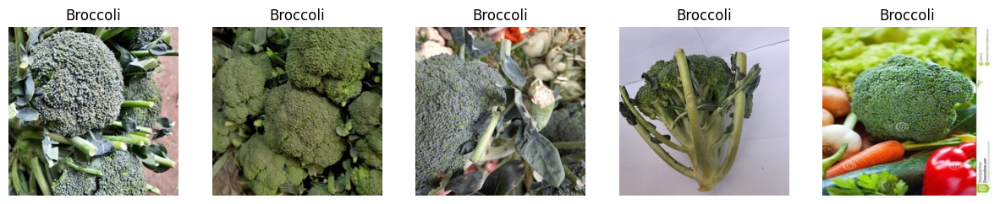

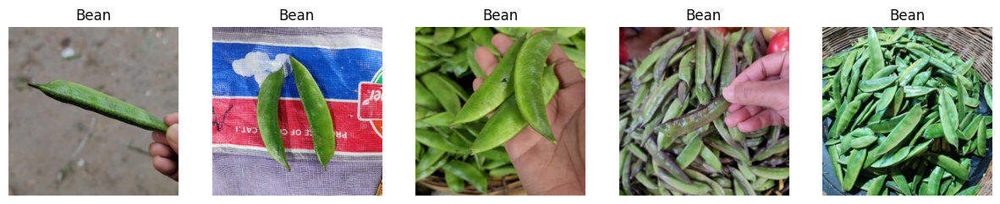

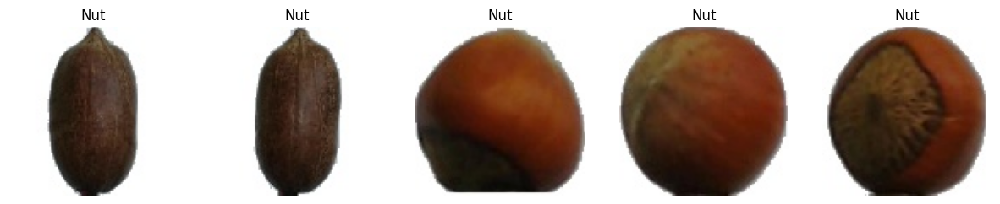

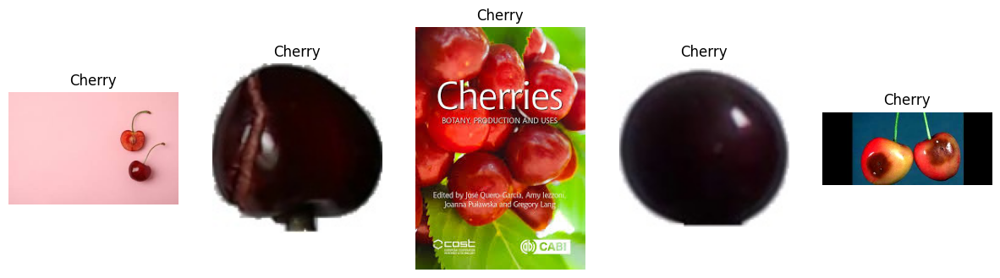

In [21]:
for category in categories:
    folder_path = os.path.join(DATASET_DIR, category)
    show_images(folder_path, category)

Для класса **Tomato**:  
Большая часть изображений в данном классе растянуты и сплюснуты.

Для класса **Radish**:  
Редис на изображениях светлый и вытянутый. Так же бывает круглый и красный редис, но в датасете такие не представлены

Для класса **Brinjal**:  
Все баклажаны в датасете зеленого цвета. Баклажаны чаще встречаются фиолетового цвета, в датасете не представлены.

Для класса **Pumpkin**:  
Тыквы в датасете все одинакового цвета, больше похожи на арбуз. Тыквы часто бывают рыжего цвета, но в датасете не представлены

**Небольшие изображения (100*100px)** при увеличении имеют низкое качество. В будущем это может плохо сказаться на обучении модели, так как такие изображения содержат маленькую детализацию и объект на них тяжелее классифицировать.

Присутствуют изображения с измененной контрастностью и резкозтью.  
Также присутствуют изображения повернутые на угол. У таких изображений в углах с отсутствием изображения залит белый цвет.

## 4. Визуализация данных

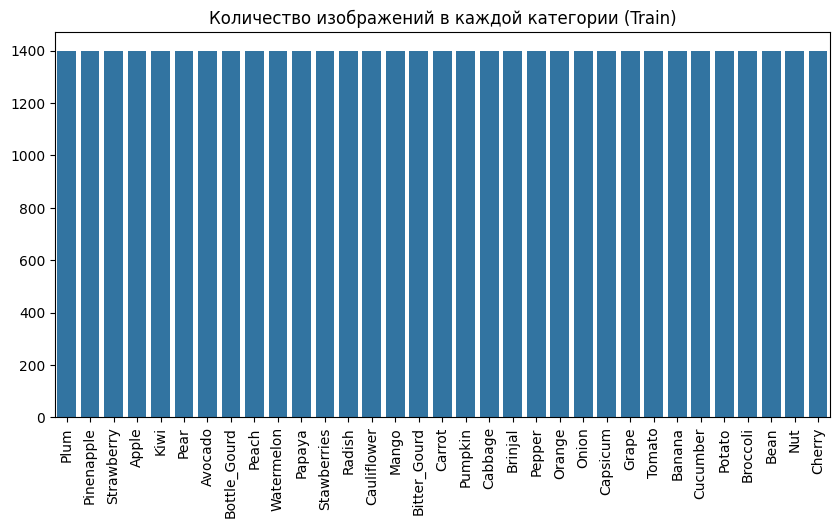

In [22]:
plt.figure(figsize=(10, 5))
sns.barplot(x=list(category_counts.keys()), y=list(category_counts.values()))
plt.xticks(rotation=90)
plt.title('Количество изображений в каждой категории (Train)')
plt.show()

Для каждой категории представлено 1400 изображений. Датасет хорошо сбалансирован.

## 5. Первичная предобработка изображений

### Определение размера для ресайза или нарезки изображений

Т.к. есть изображения нестандартного размера, то можно привести их к одному размеру. Ранее было принято решение использовать оптимальный размер 224*224px.

In [23]:
# DataFrame с информацией о картинках с нестандартным размером
incorrect_sized = df.loc[(df['width'] != 224) | (df['height'] != 224)]
incorrect_sized.head()

,category,name,width,height
0,Plum,32_r_78_100.jpg,100,100
1,Plum,47_r2_194_100.jpg,100,100
2,Plum,32_136_100.jpg,100,100
3,Plum,47_r2_26_100.jpg,100,100
4,Plum,32_r_99_100.jpg,100,100


In [24]:
def set_image_size(img_path:str, size:tuple[int, int]):
    img = Image.open(img_path)
    if img.mode != 'RGB':
        img = img.convert('RGB')
    ratio = img.width / img.height
    # Широкое изображение
    if ratio > 1:
        new_width = size[0]
        new_height = int(size[0] / ratio)
    # Высокое изображение
    else:
        new_height = size[1]
        new_width = int(size[1] * ratio)
    img_resized = img.resize((new_width, new_height), Image.LANCZOS)
    img_padded = ImageOps.pad(img_resized, size, color="white", centering=(0.5, 0.5))
    img_padded.save(img_path)

In [25]:
incorrect_sized = df[df['width']!=224]

for row in tqdm(incorrect_sized.values):
    path = os.path.join(DATASET_DIR, row[0], row[1])
    set_image_size(path, (224, 224))

  0%|          | 0/27924 [00:00<?, ?it/s]

In [26]:
row_list = []
for category in tqdm(categories):
    folder_path = os.path.join(DATASET_DIR, category)
    row_list.extend(check_image_sizes(folder_path, category))

print(row_list[0])

  0%|          | 0/33 [00:00<?, ?it/s]

['Plum', '32_r_78_100.jpg', 224, 224]


In [27]:
df = pd.DataFrame(row_list, columns=['category', 'name', 'width', 'height'])
df.describe()

,width,height
count,46200.0,46200.000000
mean,224.0,223.998009
std,0.0,0.274055
min,224.0,187.000000
25%,224.0,224.000000
50%,224.0,224.000000
75%,224.0,224.000000
max,224.0,225.000000


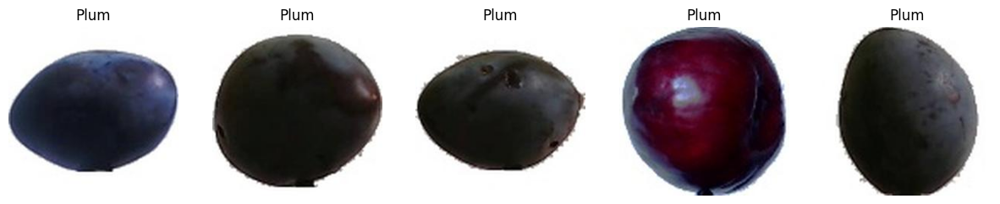

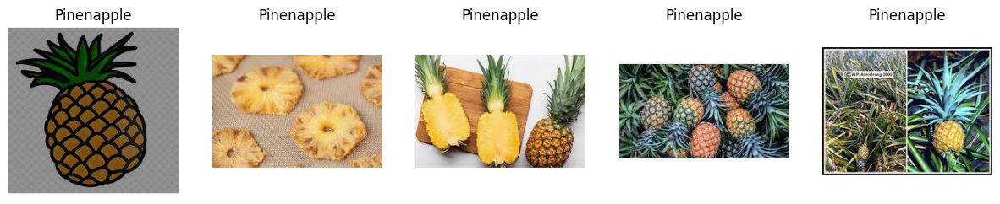

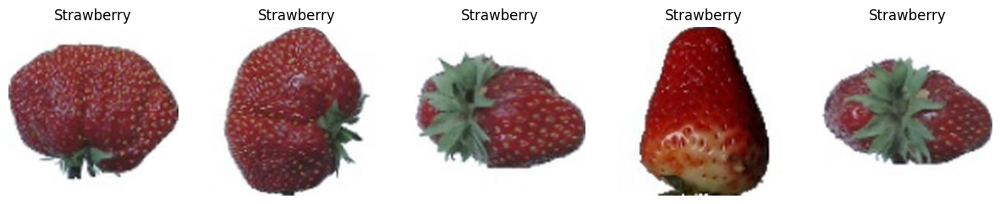

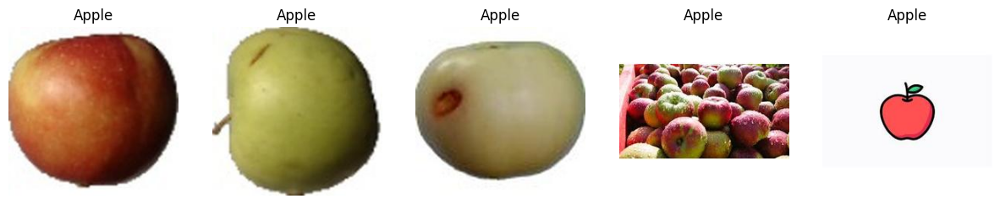

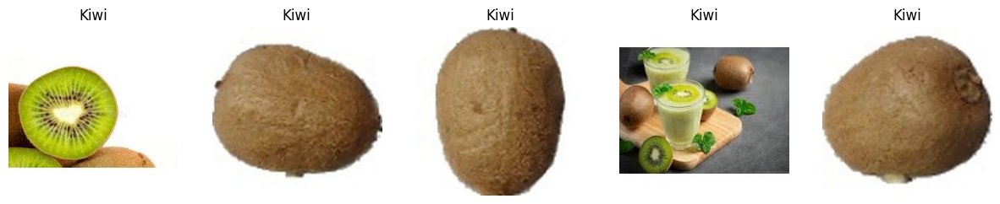

...

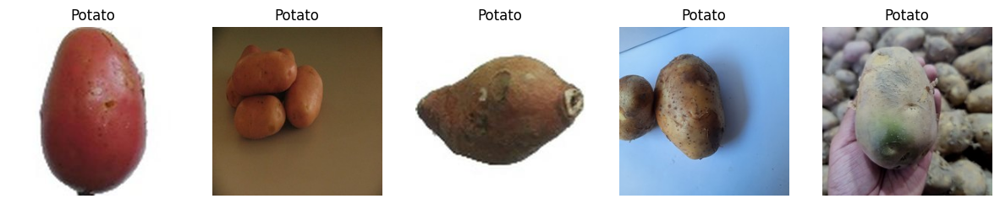

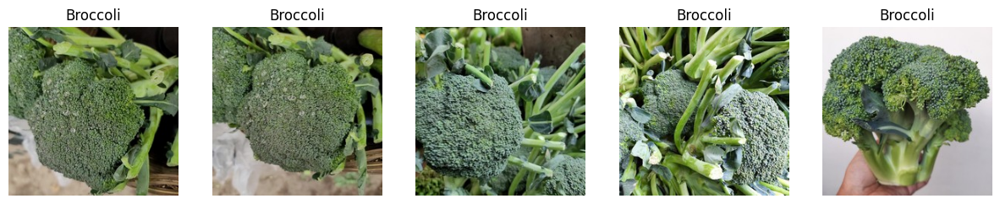

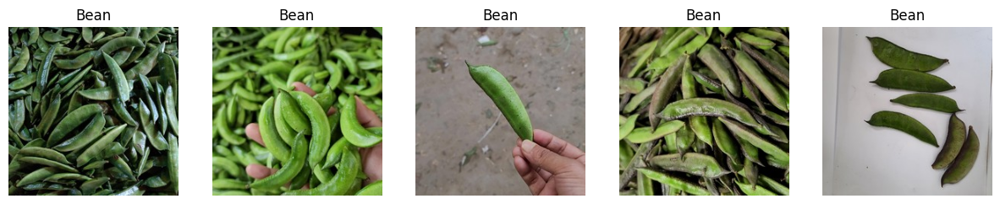

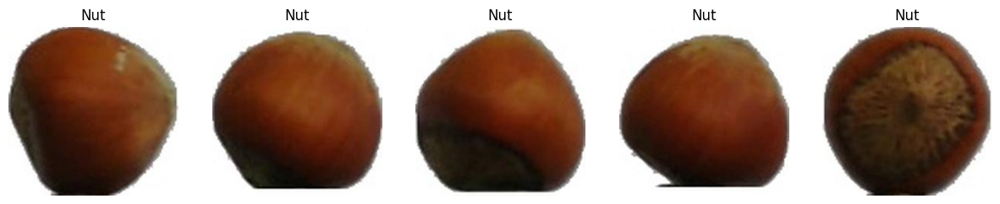

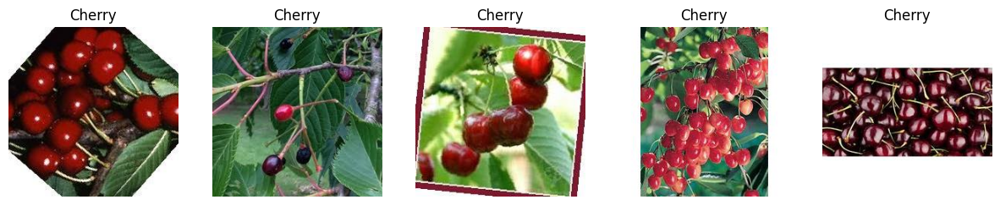

In [28]:
for category in categories:
    folder_path = os.path.join(DATASET_DIR, category)
    show_images(folder_path, category)

Датасет получилось привести к единому размеру изображений 224*224px

In [31]:
zip_path = os.path.join(DRIVE_DIR, 'dataset_eda')
shutil.make_archive(zip_path, 'zip', DATASET_DIR)

print("Архив создан:", zip_path + '.zip')

Архив создан: /content/drive/MyDrive/dataset_eda.zip
